In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
from galvani import BioLogic
import re
import os
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

In [2]:
def find_files(directory):
    '''
    finding original mpr files from stability testing
    '''
    matching_files = []
    for filename in os.listdir(directory):
        if filename.endswith(".mpr"):
            if "06_LSV" in filename or "07_CP" in filename or "08_LSV" in filename:
                matching_files.append(filename)
    return matching_files

/var/folders/nt/nxskhf6x58l5ztb03yjr39hr0000gn/T/ipykernel_42525/2376602562.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))


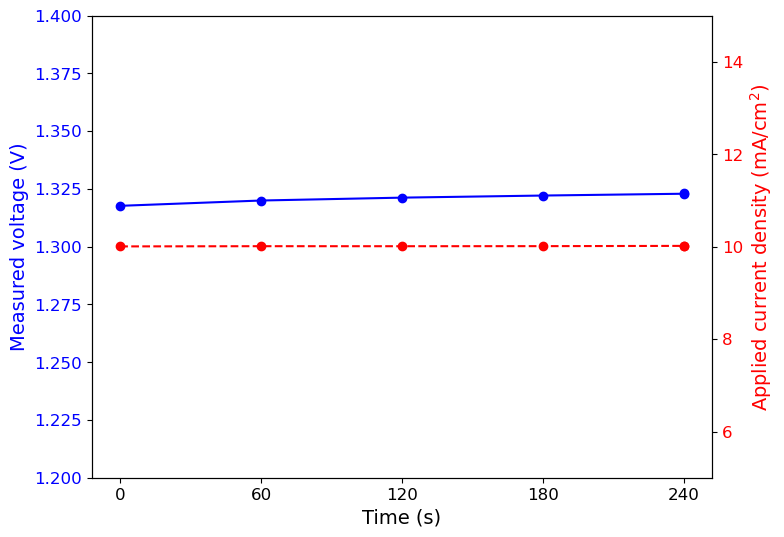

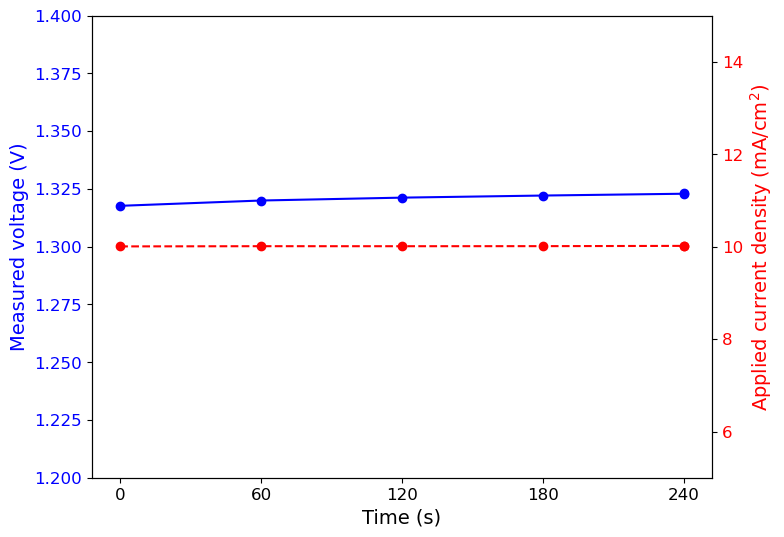

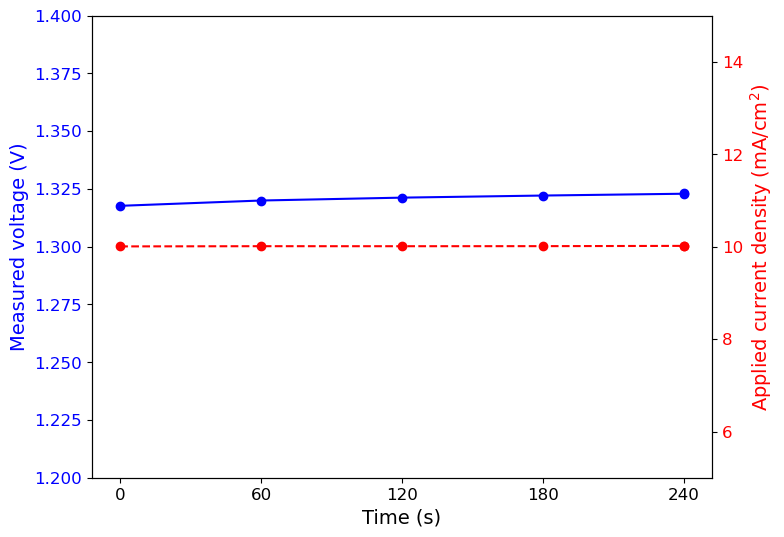

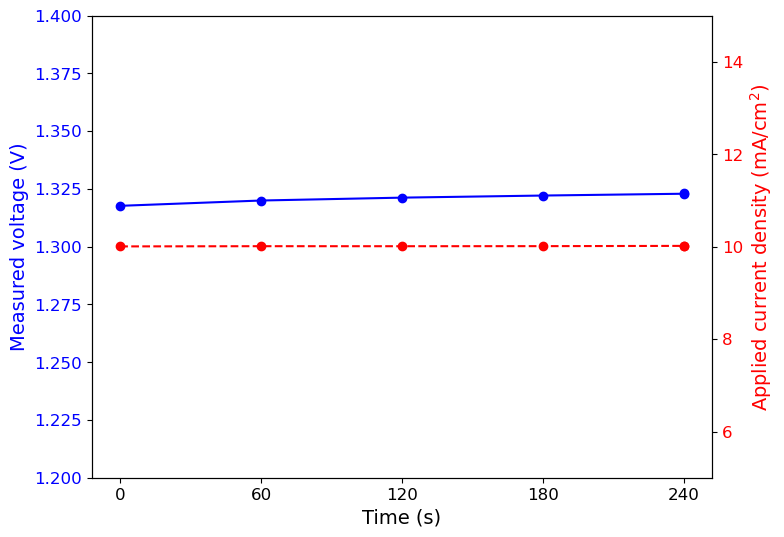

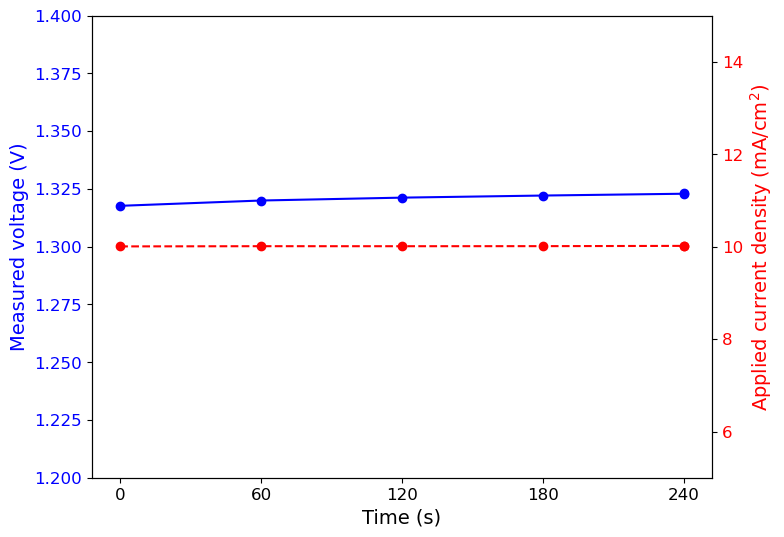

...

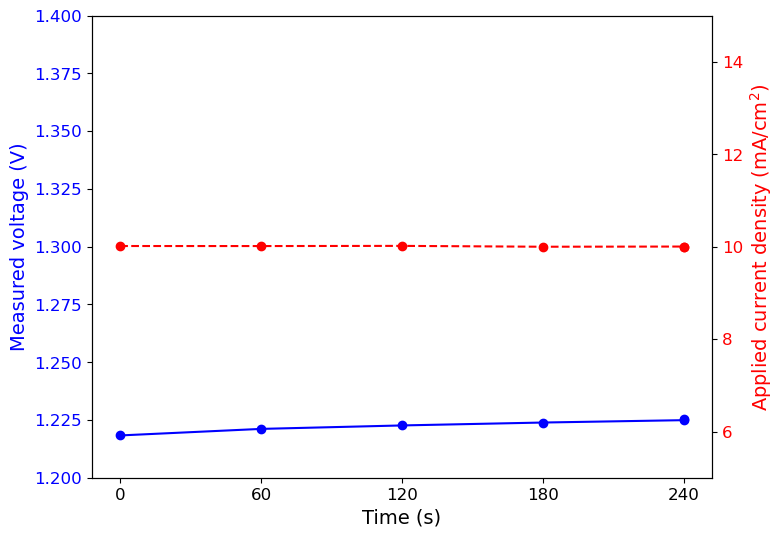

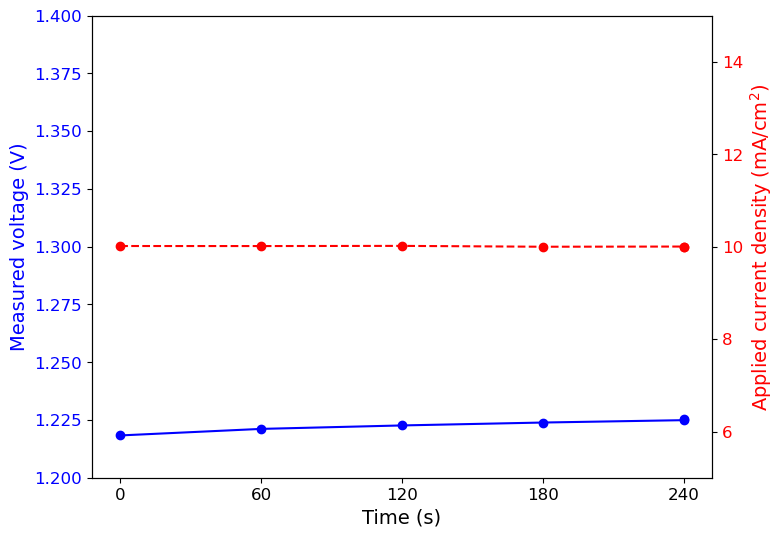

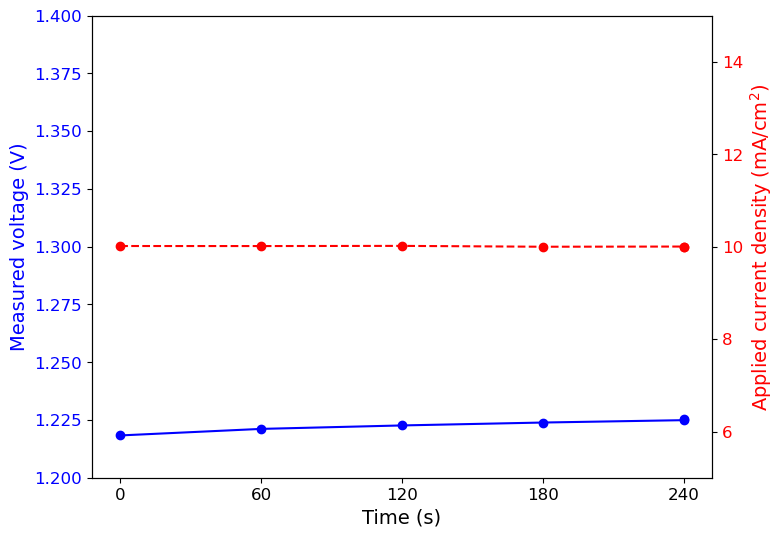

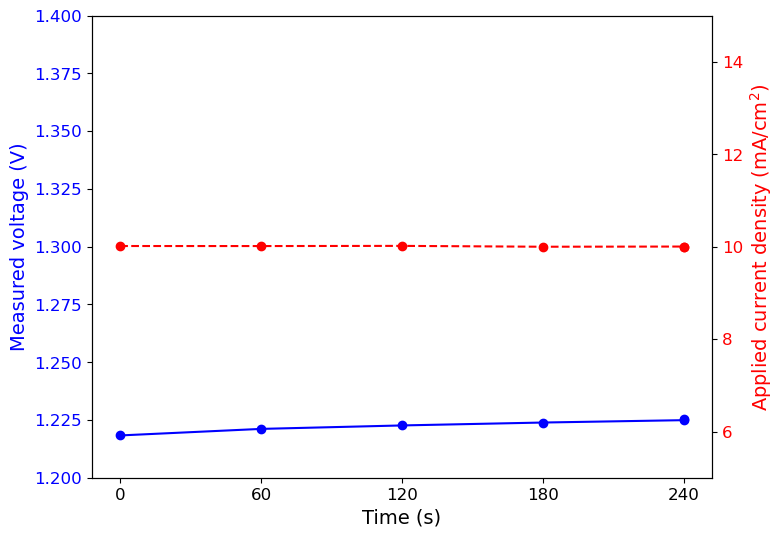

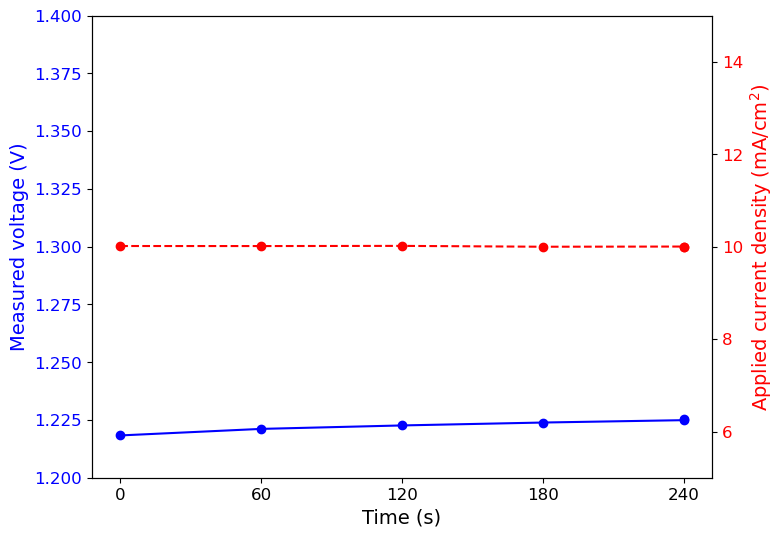

In [3]:
#extract voltage current profiles
subfolder_list = ['sub1', 'sub2', 'sub3', 'sub4', 'sub5', 'sub6', 'sub7']

for i, subfolder in enumerate(subfolder_list):
    #file directory
    input_dir=f'measurement_files/Fig5_6/{subfolder}/'
    files = find_files(input_dir)
    files = sorted(files)

    #create df
    new_df=pd.DataFrame()
    for file in files:
        mpr_file = BioLogic.MPRfile(f"{input_dir}{file}")
        df = pd.DataFrame(mpr_file.data)
        new_df = pd.concat([new_df, df], join='outer')
    new_df.reset_index(drop=True, inplace=True)
    new_df = new_df.dropna(subset=['<Ewe>/V'])
    new_df = new_df.dropna(subset=['I/mA'])
    new_df['time/s']=new_df['time/s']-min(new_df['time/s'])
    new_df.reset_index(drop=True, inplace=True)

    reference_row =0
    seg=1
    new_df['segment']=0
    for i in range(1, len(new_df)):
        if new_df.loc[i,'time/s'] - new_df.loc[i-1, 'time/s'] >60:
            new_df.loc[reference_row:i-1,'segment']=seg
            reference_row=i
            seg+=1
        if i == len(new_df)-1:
            new_df.loc[reference_row:i,'segment']=seg

    for segment in new_df['segment']:
        _df = new_df[new_df['segment']==segment]
        plt.figure(figsize=(8, 6))
        ax1 = plt.gca()
        ax1.plot(_df['time/s'], _df['<Ewe>/V'], 'o-', label='Voltage', color='b')
        ax1.set_xlabel('Time (s)', fontsize=14)
        ax1.set_ylabel('Measured voltage (V)', color='b', fontsize=14)
        ax1.tick_params(axis='y', labelcolor='b', labelsize=12)
        ax1.set_ylim(1.2, 1.4)
        ax2 = ax1.twinx()
        ax2.plot(_df['time/s'], _df['I/mA'] / 0.2, 'o--', label='Current', color='r')
        ax2.set_ylabel('Applied current density (mA/cm$^2$)', color='r', fontsize=14)
        ax2.tick_params(axis='y', labelcolor='r', labelsize=12)
        ax2.set_ylim(5, 15)
        x_ticks = np.linspace(0, int(max(_df['time/s']) - min(_df['time/s'])), num=5)
        ax1.set_xticks(x_ticks + min(_df['time/s']))  
        ax1.set_xticklabels([f"{int(tick)}" for tick in x_ticks], fontsize=12) 
        plt.savefig(f"{input_dir}/sample_number_{segment}.png", dpi=300, bbox_inches='tight')

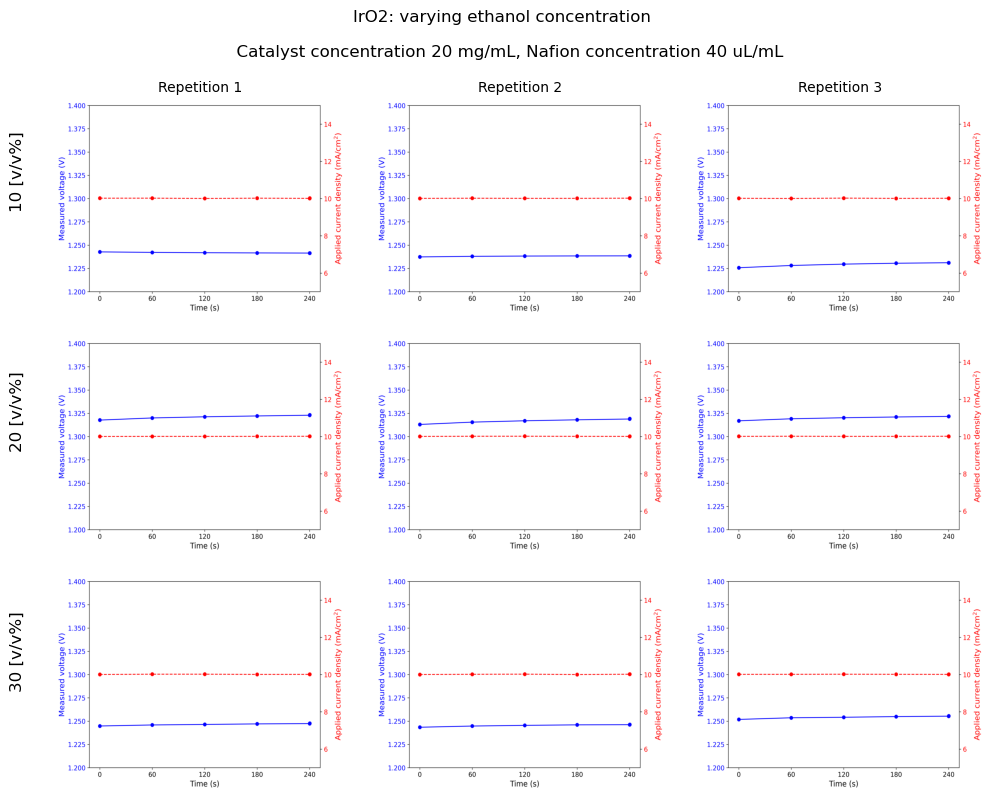

In [5]:
# Create a grid of profiles using sample info df
input_dir = 'measurement_files/Fig5_6'
df = pd.read_excel(f'{input_dir}/Measurements details.xlsx')

# Create voltage profile

fig_label = ['a', 'b', 'c']
exp_col = ['Ethanol concentration [v/v%]', 'Catalyst concentration [mg/mL]', 'Nafion concentration [uL/mL]']
grid = [(3,3), (4,3), (3,3)]

for material in set(df['Materials']):
    _df = df[df['Materials'] == material]
    for z, label in enumerate(fig_label):
        __df = _df.dropna(subset='Fig number')
        __df = __df[__df['Fig number'].str.contains(label)]
        nrow = grid[z][0]
        ncol = grid[z][1]
        ___df = __df.sort_values(by=[exp_col[z]])
        ___df.reset_index(drop=True, inplace=True)
        gs = GridSpec(nrow, ncol, width_ratios=[1]*ncol, height_ratios=[1]*nrow)
        fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(12, 3*nrow), gridspec_kw={'wspace': 0.1, 'hspace': 0.1})
        for n in range(len(___df)):
            subfolder = ___df.loc[n, 'subfolder']
            sample_number = ___df.loc[n, 'sample number']
            ethanol_conc= ___df.loc[n, 'Ethanol concentration [v/v%]']
            catalyst_conc =___df.loc[n, 'Catalyst concentration [mg/mL]']
            nafion_conc =___df.loc[n, 'Nafion concentration [uL/mL]']
            filename = f'{input_dir}/{subfolder}/sample_number_{sample_number}.png'
            i = n // ncol
            j = n % ncol
            if os.path.exists(filename):
                img = plt.imread(filename)
                axs[i, j].imshow(img, aspect='auto')
                axs[i, j].set_axis_off()
            else:
                axs[i, j].set_facecolor('grey')  # Set the background color to grey
                axs[i, j].text(0.5, 0.5, 'Missing Data', fontsize=12, ha='center', va='center', color='black')  # Add white text in the center
                axs[i, j].tick_params(
                                axis='both',          # changes apply to both x and y-axis
                                which='both',         # both major and minor ticks are affected
                                bottom=False,         # ticks along the bottom edge are off
                                top=False,            # ticks along the top edge are off
                                left=False,           # ticks along the left edge are off
                                right=False,          # ticks along the right edge are off
                                labelbottom=False,    # labels along the bottom edge are off
                                labelleft=False       # labels along the left edge are off
                                )
        
        # Set titles for each column
        yaxis_labels = sorted(list(set(___df[exp_col[z]])))
        variable_unit = exp_col[z].split(' ')[-1]
        for col in range(ncol):
            axs[0, col].set_title(f'Repetition {col + 1}', fontsize=10)

        for row in range(nrow):
            y_position = (0.8)*(1-(1/nrow*row))
            fig.text(0.1, y_position, f"{yaxis_labels[row]} {variable_unit}", va='center', rotation='vertical', fontsize=12, ha='right')

        fixed_labels = exp_col
        fixed_variables = [ethanol_conc, catalyst_conc, nafion_conc]
        fixed_units =['v/v %','mg/mL' , 'uL/mL']
        title=material+':'
        title+=f" varying {' '.join(exp_col[z].split(' ')[:-1]).lower()} \n \n "
        yaxis_labels=[]
        for j,vlabel in enumerate(fixed_labels):
            if vlabel != exp_col[z]:
                title+= ' '+' '.join(vlabel.split()[:-1])+' '+str(fixed_variables[j])+' '+fixed_units[j]+','

        fig.suptitle(title[:-1], fontsize=12)
        plt.show()
        fig.savefig(f"{material}_{label}.png", dpi=300, bbox_inches='tight')